# Score-Based Generative Modeling

In [1]:
import functools

import matplotlib.animation as ani
import matplotlib.pyplot as plt
import numpy
import torch

from ipywidgets import interact, Dropdown
from matplotlib import rc
from tqdm.auto import tqdm

## Perturbing Data with Stochastic Differential Equations
The diffusion process can be modeled as the solution to an Itô stochastic differential equation (SDE) of the form:

\begin{equation}
    d\mathbf{x} = \mathbf{f}(\mathbf{x}, t)dt + g(\mathbf{x}, t)d\mathbf{w}
\end{equation}

where $\mathbf{f}$ is the drift coefficient, $g$ is the diffusion coefficient, $\mathbf{w}$ is the Wiener process (a.k.a Brownian motion), and $x_t$ is the state of the system at time $t$. The drift coefficient $\mathbf{f}$ models the deterministic part of the dynamics while the diffusion coefficient $g$ models the stochastic part **[1, 2]**.

### Modeling a Wiener process (a.k.a Brownian motion)

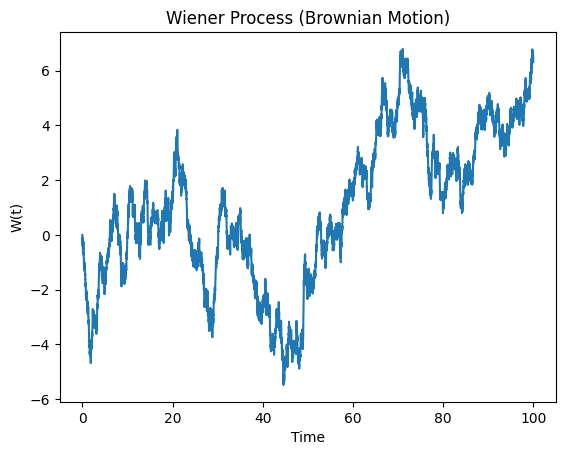

In [2]:
def wiener_process(time_steps, mu=0, sigma=1):
    dt = time_steps[1] - time_steps[0]

    dw = torch.sqrt(dt) * torch.randn_like(time_steps)
    W = torch.cumsum(dw, axis=0)
    W = torch.cat([torch.zeros(1), W])

    W = mu * time_steps + sigma * W[:-1]  # Exclude the last point to match the time vector
    
    return W


N = 10000
t = torch.linspace(0, 100, N)

W = wiener_process(t, mu=0, sigma=1)

plt.figure()
plt.plot(t, W)
plt.title('Wiener Process (Brownian Motion)')
plt.xlabel('Time')
plt.ylabel('W(t)')
plt.show()

### Choosing an SDE Model
In its thesis and paper **[1, 2]**, Song & al. propose several SDE models to perturb data from the initial distribution $p_0$ to a prior distribution $p_T$:
* Variance Exploding SDE (VE-SDE)
* Variance Preserving SDE (VP-SDE)
* sub-VP SDE

Here we will use the following SDE as suggest in this [tutorial notebook](https://colab.research.google.com/drive/120kYYBOVa1i0TD85RjlEkFjaWDxSFUx3?usp=sharing):

\begin{equation}
    d\mathbf{x} = \sigma^t d\mathbf{w} \quad t \in [0, 1]
\end{equation}

We can see that there is no drift term in this SDE, which means that the dynamics are entirely driven by the noise term. Also, in this equation, the diffusion coefficient is defined as $g(\mathbf{x}, t) = \sigma^t$. 

TODO: proof of finding a solution to this SDE (prior distribution $p_{0t}(\mathbf{x}(t) \mid \mathbf{x}(0))$)

\begin{equation}
    p_{0t}(\mathbf{x}(t) \mid \mathbf{x}(0)) = \mathcal{N}\left(\mathbf{x}(t); \mathbf{x}(0), \frac{1}{2 \log \sigma}(\sigma^2 - 1)\mathbf{I}\right)
\end{equation}

In [3]:
# Define the SDE
def sde_std(t, sigma):
    return torch.sqrt((sigma ** (2 * t) - 1.0) / (2 * numpy.log(sigma)))

def sde_diffusion_coefficient(t, sigma):
    return sigma ** t

def sde_drift(t, sigma):
    return 0.0

### Data Perturbation (the One-Dimensional Case)

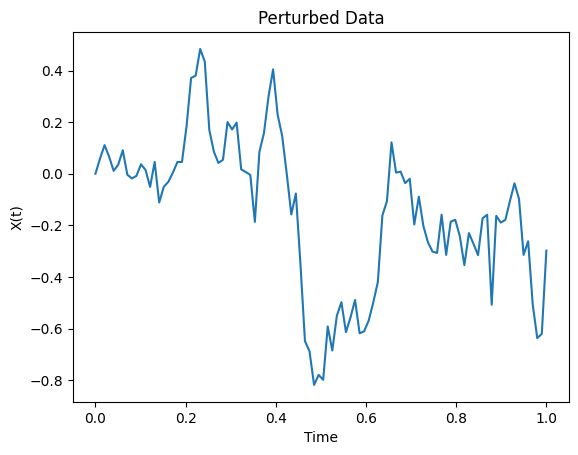

In [4]:
n_steps = 100
sigma = 1.5

# Define the SDE for the given sigma
g = functools.partial(sde_diffusion_coefficient, sigma=sigma)
f = functools.partial(sde_drift, sigma=sigma)

t = torch.linspace(0, 1, n_steps)
dt = t[1] - t[0]

def dw(dt):
    return torch.sqrt(dt) * torch.randn_like(dt)

X = torch.zeros_like(t)
X[0] = 0.0

for i in range(1, n_steps):
    X[i] = X[i - 1] + f(t[i - 1]) * dt + g(t[i - 1]) * dw(dt)
    
plt.figure()
plt.plot(t, X)
plt.title('Perturbed Data')
plt.xlabel('Time')
plt.ylabel('X(t)')
plt.show()


### Data Perturbation (the Two-Dimensional Case)

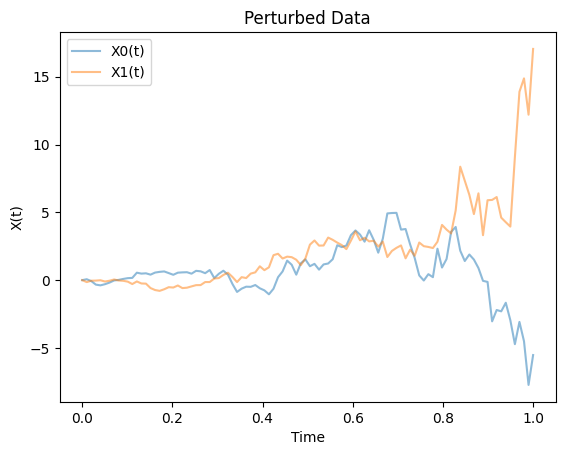

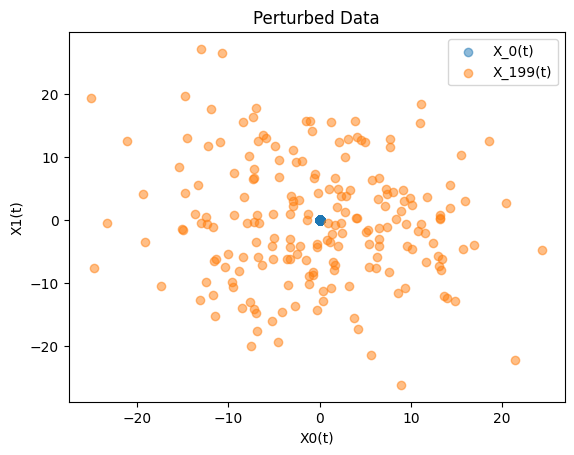

In [5]:
n_steps = 100
n_samples = 200
sigma = 25
epsilon = 1e-5

# Define the SDE for the given sigma
g = functools.partial(sde_diffusion_coefficient, sigma=sigma)
f = functools.partial(sde_drift, sigma=sigma)

t = torch.linspace(0, 1, n_steps)
dt = t[1] - t[0]

def dw(dt):
    return torch.sqrt(dt) * torch.randn_like(dt)

X = torch.zeros((n_steps, 2))
X[0] = torch.zeros(2)

for i in range(1, n_steps):
    for j in range(2):
        X[i, j] = X[i - 1, j] + f(t[i - 1]) * dt + g(t[i - 1]) * dw(dt)
    
plt.figure()
plt.plot(t, X[:, 0], alpha=0.5, label='X0(t)')
plt.plot(t, X[:, 1], alpha=0.5, label='X1(t)')
plt.title('Perturbed Data')
plt.xlabel('Time')
plt.ylabel('X(t)')
plt.legend()

X = torch.zeros((n_steps, n_samples, 2))
X[0] = torch.zeros(n_samples, 2)

for i in range(1, n_steps):
    for j in range(n_samples):
        for k in range(2):
            X[i, j, k] = X[i - 1, j, k] + f(t[i - 1]) * dt + g(t[i - 1]) * dw(dt)
        
plt.figure()
plt.scatter(X[0, :, 0], X[0, :, 1], alpha=0.5, label='X_0(t)')
plt.scatter(X[-1, :, 0], X[-1, :, 1], alpha=0.5, label=f'X_{n_samples - 1}(t)')
plt.title('Perturbed Data')
plt.xlabel('X0(t)')
plt.ylabel('X1(t)')
plt.legend()
plt.show()

The previous implementation is not as efficient as it could be. Note that $d\mathbf{w}$ is the only stochastic term in the SDE. In order to vectorize the previous implementation, we need to generate that random variable for each features and samples at each time step.

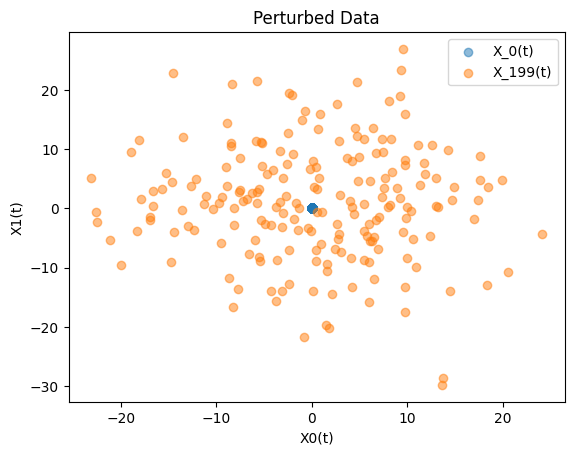

In [6]:
n_steps = 100
n_samples = 200
sigma = 25
epsilon = 1e-5

# Define the SDE for the given sigma
g = functools.partial(sde_diffusion_coefficient, sigma=sigma)
f = functools.partial(sde_drift, sigma=sigma)

t = torch.linspace(0, 1, n_steps)
dt = t[1] - t[0]

def dw(dt, n_samples, n_features):
    return torch.sqrt(dt) * torch.randn(n_samples, n_features)

X = torch.zeros((n_steps, n_samples, 2))
X[0] = torch.zeros(n_samples, 2)

for i in range(1, n_steps):
    X[i] = X[i - 1] + f(t[i - 1]) * dt + g(t[i - 1]) * dw(dt, n_samples, 2)
    
plt.figure()
plt.scatter(X[0, :, 0], X[0, :, 1], alpha=0.5, label='X_0(t)')
plt.scatter(X[-1, :, 0], X[-1, :, 1], alpha=0.5, label=f'X_{n_samples - 1}(t)')
plt.title('Perturbed Data')
plt.xlabel('X0(t)')
plt.ylabel('X1(t)')
plt.legend()
plt.show()

We can now use a more complex distribution like a two dimensional multivariate Gaussian and see how the diffusion process perturbs the samples over time. In the following example, we assign a different label to each cluster of samples that we will use later for conditional sampling.

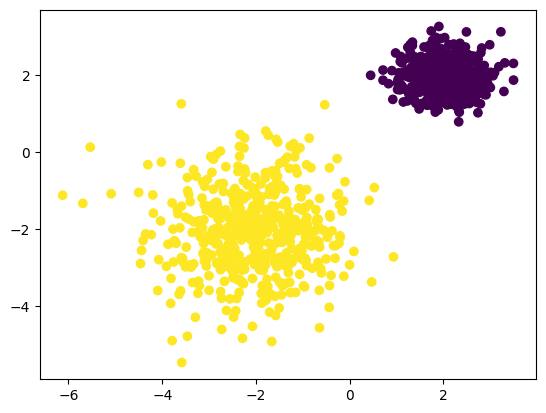

In [7]:
n_samples = 1000

first_mode = torch.distributions.MultivariateNormal(torch.tensor([2.0, 2.0]), torch.eye(2) * 0.2)
second_mode = torch.distributions.MultivariateNormal(torch.tensor([-2.0, -2.0]), torch.eye(2) * 1)

def sample_data(n_samples):
    condition = torch.ones((n_samples, 1))
    condition[:n_samples // 2] = 0

    data = torch.cat([
        first_mode.sample((n_samples // 2,)),
        second_mode.sample((n_samples // 2,))
    ], dim=0)
    
    return data, condition

data, condition = sample_data(n_samples)

dataset = torch.utils.data.TensorDataset(data, condition)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=32, shuffle=True)

# plot the data
plt.figure()
plt.scatter(data[:, 0], data[:, 1], c=condition)
plt.show()

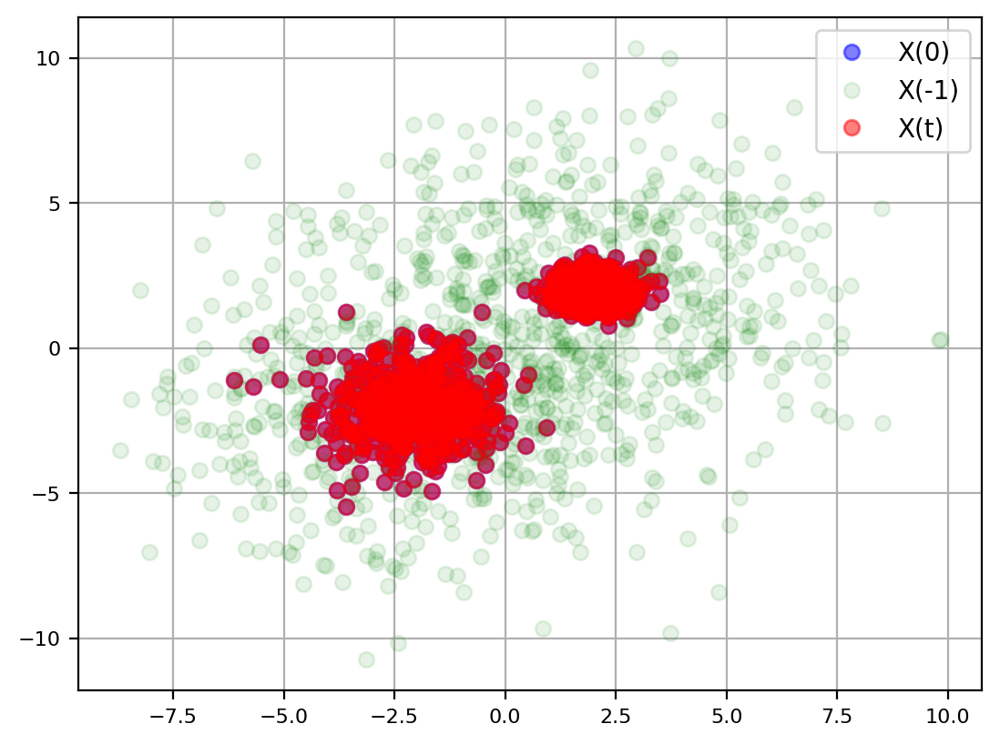

Animation size has reached 21051789 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [8]:
n_steps = 100
sigma = 5
epsilon = 1e-5

# Define the SDE for the given sigma
g = functools.partial(sde_diffusion_coefficient, sigma=sigma)
f = functools.partial(sde_drift, sigma=sigma)

t = torch.linspace(0, 1, n_steps)
dt = t[1] - t[0]

def dw(dt, n_samples, n_features):
    return torch.sqrt(dt) * torch.randn(n_samples, n_features)

X = torch.zeros((n_steps, n_samples, 2))
X[0] = data

for i in range(1, n_steps):
    X[i] = X[i - 1] + f(t[i - 1]) * dt + g(t[i - 1]) * dw(dt, n_samples, 2)

figure = plt.figure(dpi=200)
axe = figure.add_subplot(111)
axe.grid(True)
axe.tick_params(labelsize=8)

x_0 = axe.plot(X[0, :, 0], X[0, :, 1], "ob", alpha=0.5, label='X(0)')
axe.plot(X[-1, :, 0], X[-1, :, 1], "og", alpha=0.1, label='X(-1)')
x_t = axe.plot(X[0, :, 0], X[0, :, 1], "or", alpha=0.5, label='X(t)')

plt.legend()
plt.show()
    
rc('animation', html='jshtml')

def __animate__(i):
    x_t[0].set_data(X[i, :, 0], X[i, :, 1])

animation = ani.FuncAnimation(figure, __animate__, frames=n_steps, interval=100, repeat=True)
animation

## Generating Samples with the Reverse SDE

Sampling could be done by reversing the SDE. The reverse SDE is defined as:

\begin{equation}
    d\mathbf{x} = \left[\mathbf{f}(\mathbf{x}, t) - g^2(t) \nabla_x \log p_t(\mathbf{x})\right]dt + g(t)d\hat{\mathbf{w}}
\end{equation}

Where $\nabla_x \log p_t(\mathbf{x})$ is the score function that could be learned with a neural network such $s_\theta(\mathbf{x}, t)$ and $\hat{\mathbf{w}}$ is the reverse Wiener process. In the case of the previously used SDE, the reverse-time SDE is given by:

\begin{equation}
    d\mathbf{x} = -\sigma^{2t} s_\theta(\mathbf{x}, t)dt + \sigma^t d\hat{\mathbf{w}}
\end{equation}

Many solver methods can be used to solve this SDE. Here we will use the Euler-Maruyama method. When applied to the reverse SDE, is given by the following update rule:

\begin{equation}
    \mathbf{x}_{t - \Delta t} = \mathbf{x}_t + \sigma^{2t} s_\theta(\mathbf{x}, t) \Delta t + \sigma^t \sqrt{\Delta t} \mathbf{z}_t
\end{equation}

Where $\mathbf{z}_t \sim \mathcal{N}\left[\mathbf{0}, g^2(t) \Delta t \mathbf{I}\right]$

## Time-Dependent Score-Based Model
First, in order to approximate the score function $\nabla_t \log p_t(\mathbf{x} = s_\theta(\mathbf{x}, t)$, we will use a simple neural network where we add the time information via Gaussian random features as shown in this [tutorial notebook](https://colab.research.google.com/drive/120kYYBOVa1i0TD85RjlEkFjaWDxSFUx3?usp=sharing). Further information about the objective function and the training process can be found in the same notebook.

In [9]:
class GaussianFourierProjection(torch.nn.Module):
    def __init__(self, embedding_dim, scale=30.0):
        super(GaussianFourierProjection, self).__init__()
        
        self.weight = torch.nn.Parameter(torch.randn(embedding_dim // 2) * scale, requires_grad=False)
        
    def forward(self, x):
        x_proj = x[:, None] * self.weight[None, :] * 2 * numpy.pi
        return torch.cat([torch.sin(x_proj), torch.cos(x_proj)], dim=-1)
    

class ScoreFunction(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size, std, embedding_dim=64):
        super(ScoreFunction, self).__init__()
        
        self.embedding = torch.nn.Sequential(
            GaussianFourierProjection(embedding_dim),
            torch.nn.Linear(embedding_dim, embedding_dim),
            torch.nn.ReLU(),
        )
        
        self.fc1 = torch.nn.Linear(input_size, hidden_size)
        self.concat1 = torch.nn.Linear(embedding_dim, hidden_size)
        self.fc2 = torch.nn.Linear(hidden_size, hidden_size)
        self.concat2 = torch.nn.Linear(embedding_dim, hidden_size)
        self.fc3 = torch.nn.Linear(hidden_size, output_size)
        
        self.activation = torch.nn.Sigmoid()
        
        self.std = std
        
    def forward(self, x, t):
        embedding = self.activation(self.embedding(t))
        
        hidden = self.activation(self.fc1(x))
        hidden = hidden + self.concat1(embedding)
        hidden = self.activation(self.fc2(hidden))
        hidden = hidden + self.concat2(embedding)
        hidden = self.fc3(hidden)

        return hidden / self.std(t)[:, None]

The forward process will differ a bit from the previous one in the [Perturbing Data with Stochastic Differential Equations](#Perturbing-Data-with-Stochastic-Differential-Equations) section. Instead of using a continuous time, we will generate random time steps for each sample and feature. It work the same as if we built a dataset of pertubed data label with the non pertubed data on a continuous time steps and shuffle it before the training. The shuffle of the data is important to train a neural network in order to not bias the convergence of the learning toward a suboptimal solution.

In [10]:
def loss_fn(model, x, std, epsilon=1e-5):
    t = torch.rand(x.shape[0]) * (1 - epsilon) + epsilon  # Uniform distribution to cover the whole interval
    drift_coefficient = torch.randn_like(x)
    std = std(t)
    
    perturbed_x = x + drift_coefficient * std[:, None]
    
    score = model(perturbed_x, t)
    
    return torch.mean(torch.sum((score * std[:, None] + drift_coefficient) ** 2, dim=1))

In [11]:
def train(score_net, dataloader, std, epochs=100, lr=1e-3):
    optimizer = torch.optim.Adam(score_net.parameters(), lr=lr)

    losses = []
    for epoch in tqdm(range(epochs), desc="Training"):
        avg_loss = 0.0
        num_items = 0

        for sample, _condition in dataloader:
            loss = loss_fn(score_net, sample, std)
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            avg_loss += loss.item() * sample.shape[0]
            num_items += sample.shape[0]
        
        avg_loss /= num_items
        losses.append(avg_loss)

    return score_net, losses

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

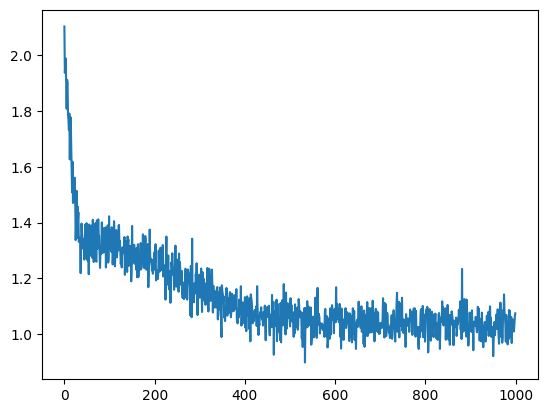

In [12]:
# Hyperparameters
SIGMA = 5.0
N_EPOCHS = 1000
LEARNING_RATE = 1e-4

# Define the SDE functions
std = functools.partial(sde_std, sigma=SIGMA)
diffusion_coefficient = functools.partial(sde_diffusion_coefficient, sigma=SIGMA)
drift = functools.partial(sde_drift, sigma=SIGMA)

# Train the score-based model
score_net = ScoreFunction(2, 64, 2, std=std, embedding_dim=64)
score_net, losses = train(score_net, dataloader, std, epochs=N_EPOCHS, lr=LEARNING_RATE)

plt.figure()
plt.plot(losses)
plt.show()

c:\Users\GLauz\Documents\Files\project\diffusions\.venv\Lib\site-packages\torch\functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ..\aten\src\ATen\native\TensorShape.cpp:3588.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


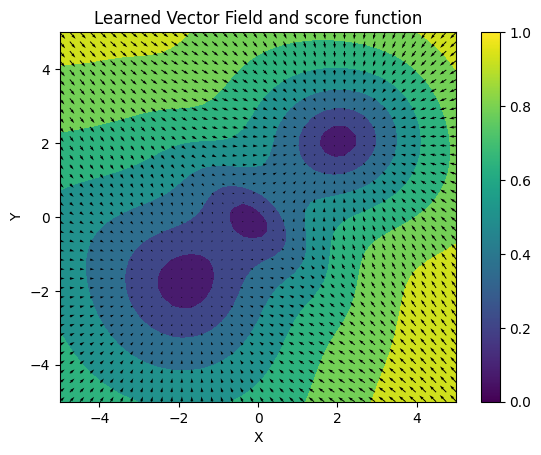

In [13]:
n = 40
x = torch.linspace(-5, 5, n)
y = torch.linspace(-5, 5, n)
X, Y = torch.meshgrid(x, y)

with torch.no_grad():

    t = (torch.ones_like(X) * 0.5).flatten()

    input = torch.stack([X.flatten(), Y.flatten()], dim=-1)
    score = score_net(input, t).numpy()
    score = score.reshape(n, n, 2)

    plt.figure()
    plt.contourf(X, Y, torch.norm(torch.tensor(score), dim=-1).reshape(n, n))
    plt.quiver(X, Y, score[:, :, 0], score[:, :, 1])
    plt.title('Learned Vector Field and score function')
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.colorbar()
    plt.show()

Once the score-based model trained to match the score of pertubed data, we can use it to sample from the prior distribution using the reverse-time SDE defined earlier.

In [14]:
n_steps = 20
n_samples = 200
epsilon = 1e-5

# Define the SDE for the given sigma
std = functools.partial(sde_std, sigma=SIGMA)
g = functools.partial(sde_diffusion_coefficient, sigma=SIGMA)
f = functools.partial(sde_drift, sigma=SIGMA)

time_steps = torch.linspace(1, epsilon, n_steps)  # Reverse the time
dt = time_steps[0] - time_steps[1]

Y = torch.zeros((n_steps, n_samples, 2))
Y[0] = torch.randn(n_samples, 2) * std(time_steps[0])

In [15]:
diffusion_coefficient = torch.zeros((n_steps,))
diffusion_coefficient[0] = g(time_steps[0])

reverse_brownian_motion = torch.zeros((n_steps,))

diffusion_coeficient_step = torch.zeros((n_steps,))
diffusion_coeficient_step[0] = g(time_steps[0]) ** 2 * dt

score_function_x = torch.zeros((n_steps,))
score_function_y = torch.zeros((n_steps,))
x_values = torch.zeros((n_steps,))
y_values = torch.zeros((n_steps,))


with torch.no_grad():
    for i in range(1, n_steps):
        t = torch.ones((n_samples,)) * time_steps[i]

        z_t = torch.distributions.Normal(0, g(t[0])**2 * dt).sample((n_samples, 2))

        diffusion_coefficient[i] = g(time_steps[i])
        diffusion_coeficient_step[i] = g(time_steps[i]) ** 2 * dt
        reverse_brownian_motion[i] = z_t[0, 0]

        score = (g(t)**2)[:, None] * score_net(Y[i-1], t) * dt
        score_function_x[i] = score[0, 0]
        score_function_y[i] = score[0, 1]

        x_values[i] = Y[i-1, 0, 0]
        y_values[i] = Y[i-1, 0, 1]

        Y[i] = Y[i-1] + f(t) * dt + (g(t)**2)[:, None] * score_net(Y[i-1], t) * dt + g(t)[:, None] * torch.sqrt(dt) * z_t

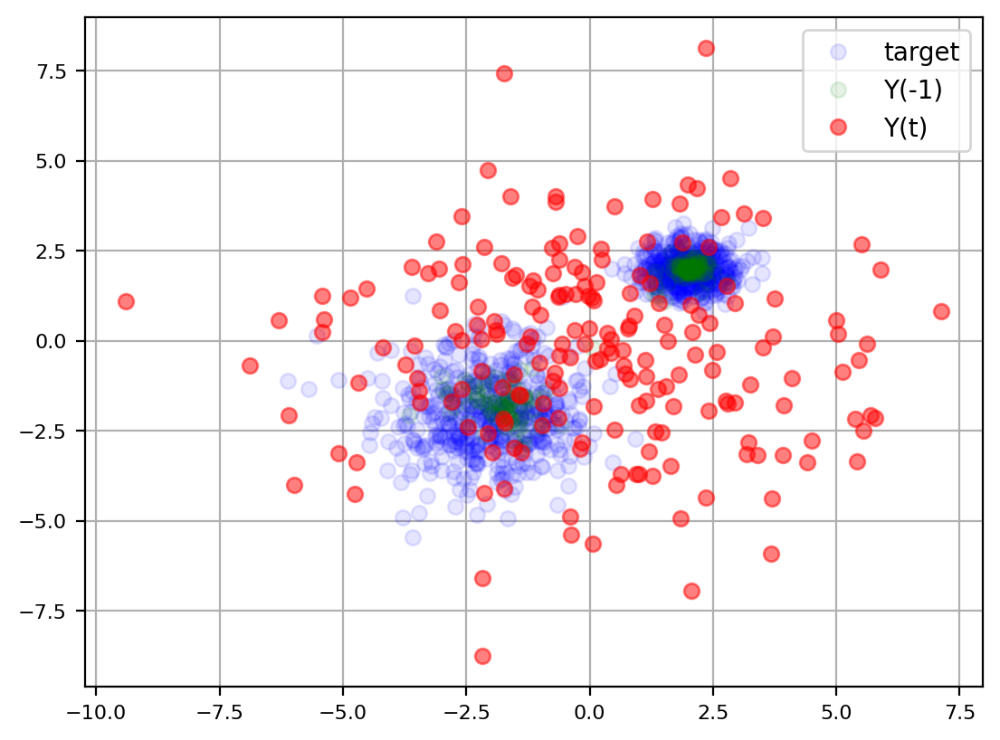

In [16]:
figure = plt.figure(dpi=200)
axe = figure.add_subplot(111)
axe.grid(True)
axe.tick_params(labelsize=8)

Y = Y[:-1, :, :]

# x_0 = axe.plot(Y[0, :, 0], Y[0, :, 1], "og", alpha=0.5, label='Y(0)')
axe.plot(data[:, 0], data[:, 1], "ob", alpha=0.1, label='target')
x_t = axe.plot(Y[-1, :, 0], Y[-1, :, 1], "og", alpha=0.1, label='Y(-1)')
x_t = axe.plot(Y[0, :, 0], Y[0, :, 1], "or", alpha=0.5, label='Y(t)')

plt.legend()
plt.show()
    
rc('animation', html='jshtml')

def __animate__(i):
    x_t[0].set_data(Y[i, :, 0], Y[i, :, 1])

animation = ani.FuncAnimation(figure, __animate__, frames=n_steps-1, interval=100, repeat=True)
animation

## Conditional sampling
As a derivation of Bayes rule, is it possible to conditionnaly generate sample with this framework **[2]**. Let $\mathbf{x}$ and $\mathbf{y}$ two random variables and where we know the forward process $p(\mathbf{y} \mid \mathbf{x})$. The inverse problem could be formulate as follow:

\begin{equation}
    p(\mathbf{x} \mid \mathbf{y}) = \frac{p(\mathbf{x})p(\mathbf{y} \mid \mathbf{x})}{p(\mathbf{y})} = \frac{p(\mathbf{x})p(\mathbf{y} \mid \mathbf{x})}{\int p(\mathbf{x})p(\mathbf{y} \mid \mathbf{x})d\mathbf{x}}
\end{equation}

Which as been shown by **[\[2\]](#references)** that it can be simplify using the score function instead of the density probabilities:

\begin{equation}
    \nabla_\mathbf{x} \log p_t(\mathbf{x}(t) \mid \mathbf{y}) \approx \nabla_\mathbf{x} \log p_t(\mathbf{x}(t)) + \nabla_\mathbf{x} \log p_t(\hat{\mathbf{y}}(t) \mid \mathbf{x}(t)) \approx s_{\theta*}(\mathbf{x}(t), t) + \nabla_\mathbf{x} \log p_t(\hat{\mathbf{y}}(t) \mid \mathbf{x}(t))
\end{equation}

Where $\hat{\mathbf{y}}(t)$ is a sample from $p(\mathbf{y}(t) \mid \mathbf{y})$. Like previously, but with a condition we could estimate $s_{\theta*}(\mathbf{x}(t), t)$ with a neural network. Giving us the following reverse-time SDE (note the addition of the $\nabla_\mathbf{x} \log p_t(\hat{\mathbf{y}} \mid \mathbf{x})$ term from the previous equation):

\begin{equation}
    d\mathbf{x} = \left\{\mathbf{f}(\mathbf{x}, t) - g^2(t) \left[\nabla_x \log p_t(\mathbf{x}) + \nabla_\mathbf{x} \log p_t(\hat{\mathbf{y}} \mid \mathbf{x})\right]\right\}dt + g(t)d\hat{\mathbf{w}}
\end{equation}

For simplicity, instead of this approach, we will concatenate the condition to the input of the neural network and train it to match the score of the pertubed data with the condition.

In [17]:
class ConditionalScoreFunction(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size, std, embedding_dim=64):
        super(ConditionalScoreFunction, self).__init__()
        
        self.embedding = torch.nn.Sequential(
            GaussianFourierProjection(embedding_dim),
            torch.nn.Linear(embedding_dim, embedding_dim),
            torch.nn.ReLU(),
        )
        
        self.fc1 = torch.nn.Linear(input_size, hidden_size)
        self.concat1 = torch.nn.Linear(embedding_dim, hidden_size)
        self.fc2 = torch.nn.Linear(hidden_size, hidden_size)
        self.concat2 = torch.nn.Linear(embedding_dim, hidden_size)
        self.fc3 = torch.nn.Linear(hidden_size, output_size)
        
        self.activation = torch.nn.Sigmoid()
        
        self.std = std
        
    def forward(self, x, t, condition):
        embedding = self.activation(self.embedding(t))

        x = torch.cat([x, condition], dim=-1)
        
        hidden = self.activation(self.fc1(x))
        hidden = hidden + self.concat1(embedding)
        hidden = self.activation(self.fc2(hidden))
        hidden = hidden + self.concat2(embedding)
        hidden = self.fc3(hidden)

        return hidden / self.std(t)[:, None]

In [18]:
def conditional_loss_fn(model, x, std, condition, epsilon=1e-5):
    x = x.reshape(-1, x.shape[-1])
    condition = condition.reshape(-1, condition.shape[-1])

    t = torch.rand(x.shape[0]) * (1 - epsilon) + epsilon  # Uniform distribution to cover the whole interval
    drift_coefficient = torch.randn_like(x)
    std = std(t)
    
    perturbed_x = x + drift_coefficient * std[:, None]
    
    score = model(perturbed_x, t, condition)
    
    return torch.mean(torch.sum((score * std[:, None] + drift_coefficient) ** 2, dim=1))

In [19]:
def conditional_train(score_net, dataloader, std, epochs=100, lr=1e-3):
    optimizer = torch.optim.Adam(score_net.parameters(), lr=lr)

    losses = []
    for epoch in tqdm(range(epochs), desc="Training"):
        avg_loss = 0.0
        num_items = 0

        for sample, condition in dataloader:
            loss = conditional_loss_fn(score_net, sample, std, condition)
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            avg_loss += loss.item() * sample.shape[0]
            num_items += sample.shape[0]
        
        avg_loss /= num_items
        losses.append(avg_loss)

    return score_net, losses

Training:   0%|          | 0/100 [00:00<?, ?it/s]

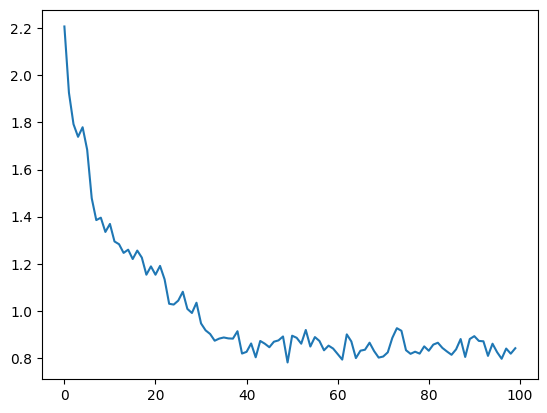

In [20]:
# Hyperparameters
SIGMA = 5.0
N_EPOCHS = 100
LEARNING_RATE = 1e-3

std = functools.partial(sde_std, sigma=SIGMA)
diffusion_coefficient = functools.partial(sde_diffusion_coefficient, sigma=SIGMA)
drift = functools.partial(sde_drift, sigma=SIGMA)

# Train the score-based model
conditional_score_net = ConditionalScoreFunction(3, 32, 2, std=std, embedding_dim=16)
conditional_score_net, losses = conditional_train(conditional_score_net, dataloader, std, epochs=N_EPOCHS, lr=LEARNING_RATE)

plt.figure()
plt.plot(losses)
plt.show()

In [25]:
@interact(condition=Dropdown(options=[0, 1], value=0, description='Condition'))
def plot_vector_field(condition):
    n = 40
    x = torch.linspace(-5, 5, n)
    y = torch.linspace(-5, 5, n)
    X, Y = torch.meshgrid(x, y)

    with torch.no_grad():
        condition = (torch.ones_like(X) * condition).reshape(-1, 1)

        t = (torch.ones_like(X) * 0.5).flatten()

        input = torch.stack([X.flatten(), Y.flatten()], dim=-1)
        score = conditional_score_net(input, t, condition).numpy()
        score = score.reshape(n, n, 2)

        plt.figure()
        plt.contourf(X, Y, torch.norm(torch.tensor(score), dim=-1).reshape(n, n))
        plt.quiver(X, Y, score[:, :, 0], score[:, :, 1])
        plt.title('Learned Vector Field and score function')
        plt.xlabel('X')
        plt.ylabel('Y')
        plt.colorbar()
        plt.show()

interactive(children=(Dropdown(description='Condition', options=(0, 1), value=0), Output()), _dom_classes=('wi…

In [22]:
n_steps = 20
n_samples = 200
epsilon = 1e-5

CONDITION = 0

time_steps = torch.linspace(1, epsilon, n_steps)  # Reverse the time
dt = time_steps[0] - time_steps[1]

Y = torch.zeros((n_steps, n_samples, 2))
Y[0] = torch.randn(n_samples, 2) * std(time_steps[0])

diffusion_coefficient = torch.zeros((n_steps,))
diffusion_coefficient[0] = g(time_steps[0])

reverse_brownian_motion = torch.zeros((n_steps,))

diffusion_coeficient_step = torch.zeros((n_steps,))
diffusion_coeficient_step[0] = g(time_steps[0]) ** 2 * dt

score_function_x = torch.zeros((n_steps,))
score_function_y = torch.zeros((n_steps,))
x_values = torch.zeros((n_steps,))
y_values = torch.zeros((n_steps,))

with torch.no_grad():
    for i in range(1, n_steps):
        t = torch.ones((n_samples,)) * time_steps[i]

        z_t = torch.distributions.Normal(0, g(t[0])**2 * dt).sample((n_samples, 2))

        diffusion_coefficient[i] = g(time_steps[i])
        diffusion_coeficient_step[i] = g(time_steps[i]) ** 2 * dt
        reverse_brownian_motion[i] = z_t[0, 0]

        condition = torch.ones((n_samples, 1)) * CONDITION
        input = torch.stack([Y[i-1, :, 0], Y[i-1, :, 1]], dim=-1)

        score = (g(t)**2)[:, None] * conditional_score_net(input, t, condition) * dt
        score_function_x[i] = score[0, 0]
        score_function_y[i] = score[0, 1]

        x_values[i] = Y[i-1, 0, 0]
        y_values[i] = Y[i-1, 0, 1]

        Y[i] = Y[i-1] + f(t) * dt + (g(t)**2)[:, None] * conditional_score_net(input, t, condition) * dt + g(t)[:, None] * torch.sqrt(dt) * z_t

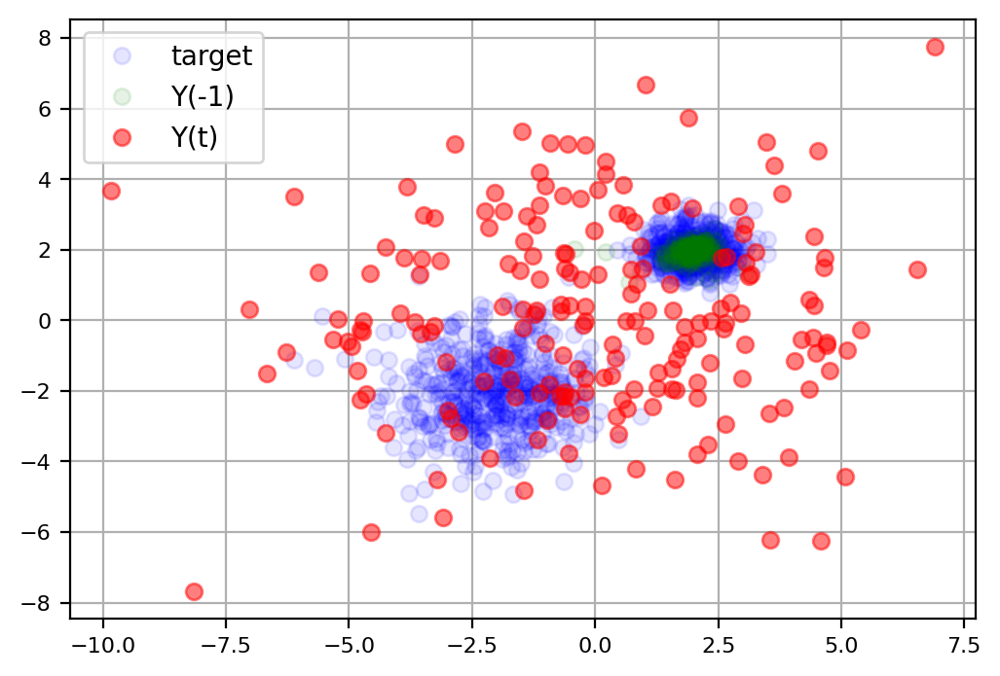

In [23]:
figure = plt.figure(figsize=(6, 4), dpi=200)
axe = figure.add_subplot(111)
axe.grid(True)
axe.tick_params(labelsize=8)

Y = Y[:-1, :, :]

axe.plot(data[:, 0], data[:, 1], "ob", alpha=0.1, label='target')
x_t = axe.plot(Y[-1, :, 0], Y[-1, :, 1], "og", alpha=0.1, label='Y(-1)')
x_t = axe.plot(Y[0, :, 0], Y[0, :, 1], "or", alpha=0.5, label='Y(t)')

plt.legend()
plt.show()
    
rc('animation', html='jshtml')

def __animate__(i):
    x_t[0].set_data(Y[i, :, 0], Y[i, :, 1])

animation = ani.FuncAnimation(figure, __animate__, frames=n_steps-1, interval=100, repeat=True)
animation